In [ ]:
"""
This is different then iEEG data! This is scalp EEG EDF data from here: 
https://www.physionet.org/content/chbmit/1.0.0/

But it is still useful to get a sense of how EEG might look and how we could do 
better compression with more complete datasets

I do have access to more iEEG data but that data is proprietary and not open.
"""



In [16]:
import pyedflib
import numpy as np
import seaborn as sns

# Path to the EDF file
edf_file_path = "edf_data/chb01_01.edf"

# Open the EDF file
edf_reader = pyedflib.EdfReader(edf_file_path)

# Get the number of signals (channels)
num_signals = edf_reader.signals_in_file

# Initialize an empty list to store the data
data = []

# Read each signal (channel) and append to the data list
for i in range(num_signals):
    signal = edf_reader.readSignal(i)
    data.append(signal)

# Convert the list to a numpy array
data = np.array(data, dtype=np.int16)

# Close the EDF file
edf_reader.close()

# Transpose the data to have shape (samples, channels)
data = data.T

print(data.shape)  # Should print (number_of_samples, 23)
print(data.dtype)



(921600, 23)
int16


In [3]:
921_600 / 256
# 1 hour of data!

3600.0

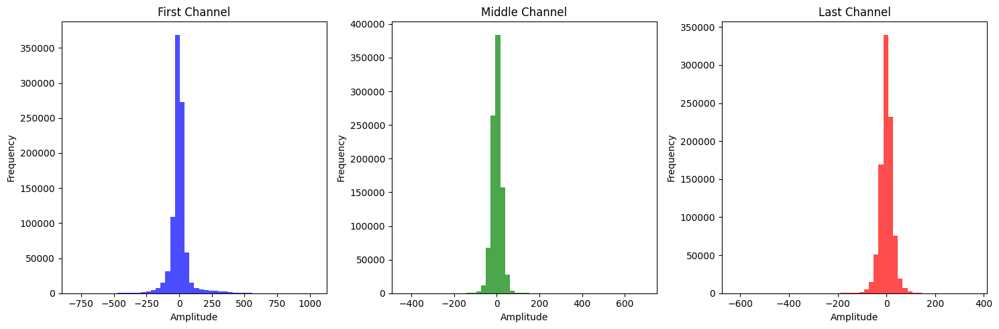

In [6]:
import matplotlib.pyplot as plt

# Select the first, middle, and last channels
first_channel = data[:, 0]
middle_channel = data[:, num_signals // 2]
last_channel = data[:, -1]

# Plot histograms for the selected channels
plt.figure(figsize=(15, 5))

# First channel
plt.subplot(1, 3, 1)
plt.hist(first_channel, bins=50, color="blue", alpha=0.7)
plt.title("First Channel")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")

# Middle channel
plt.subplot(1, 3, 2)
plt.hist(middle_channel, bins=50, color="green", alpha=0.7)
plt.title("Middle Channel")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")

# Last channel
plt.subplot(1, 3, 3)
plt.hist(last_channel, bins=50, color="red", alpha=0.7)
plt.title("Last Channel")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

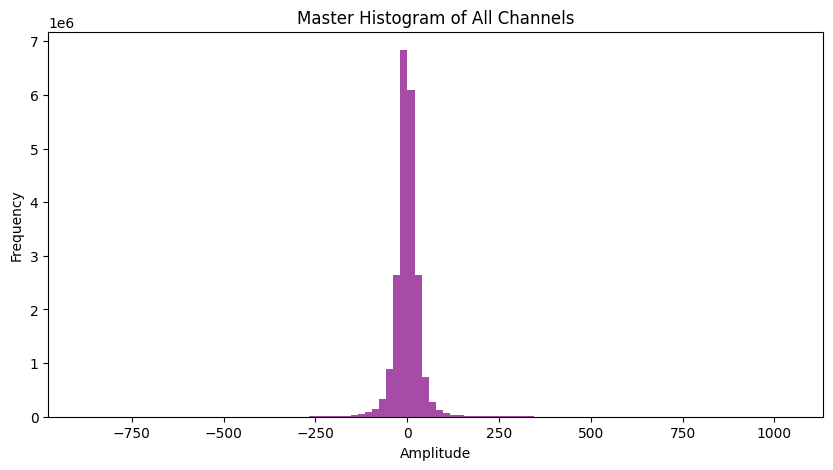

max:  1037
min:  -882


In [9]:
import matplotlib.pyplot as plt

# Flatten the data from all channels into a single array
all_channels_data = data.flatten()

# Plot the master histogram
plt.figure(figsize=(10, 5))
plt.hist(all_channels_data, bins=100, color="purple", alpha=0.7)
plt.title("Master Histogram of All Channels")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")
plt.show()

# print the max and min value in the dataset:
# Interesting to see this data hasn't been normalized like how Neuralink appears to have done.
print("max: ", np.max(all_channels_data))
print("min: ", np.min(all_channels_data))


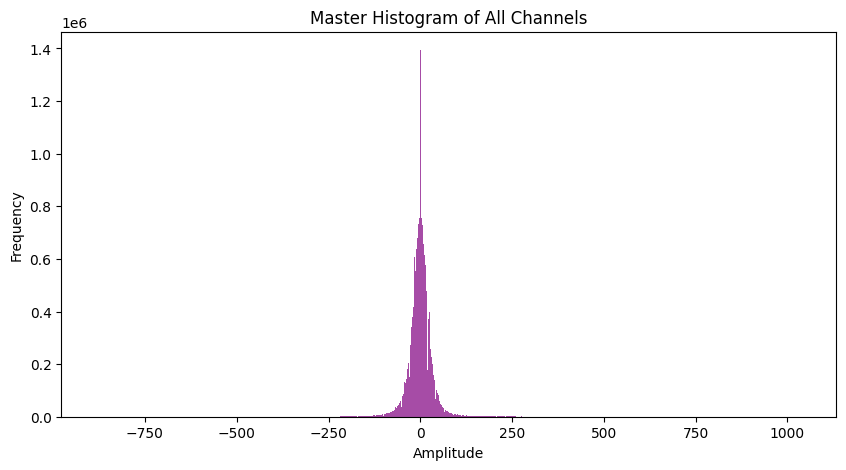

max:  1037
min:  -882


In [10]:
import matplotlib.pyplot as plt

# Flatten the data from all channels into a single array
all_channels_data = data.flatten()

# Plot the master histogram
plt.figure(figsize=(10, 5))
plt.hist(all_channels_data, bins=1000, color="purple", alpha=0.7)
plt.title("Master Histogram of All Channels")
plt.xlabel("Amplitude")
plt.ylabel("Frequency")
plt.show()

# print the max and min value in the dataset:
# Interesting to see this data hasn't been normalized like how Neuralink appears to have done.
print("max: ", np.max(all_channels_data))
print("min: ", np.min(all_channels_data))

In [12]:
import numpy as np

# Flatten the data from all channels into a single array
all_channels_data = data.flatten()

# Calculate the symmetric percentiles
percentile_7_5 = np.percentile(all_channels_data, 7.5)
percentile_92_5 = np.percentile(all_channels_data, 92.5)

percentile_2_5 = np.percentile(all_channels_data, 2.5)
percentile_97_5 = np.percentile(all_channels_data, 97.5)

percentile_0_5 = np.percentile(all_channels_data, 0.5)
percentile_99_5 = np.percentile(all_channels_data, 99.5)

print(f"85% of the data falls between {percentile_7_5} and {percentile_92_5}")
print(f"95% of the data falls between {percentile_2_5} and {percentile_97_5}")
print(f"99% of the data falls between {percentile_0_5} and {percentile_99_5}")

85% of the data falls between -38.0 and 36.0
95% of the data falls between -66.0 and 64.0
99% of the data falls between -138.0 and 167.0


In [17]:
def compare_channels(channel1: np.ndarray, channel2: np.ndarray):
    # Ensure both channels have the same length
    if channel1.shape != channel2.shape:
        raise ValueError("Both channels must have the same length")

    # Compare the values at each index
    same_values = channel1 == channel2

    # Calculate the number of overlapping values
    overlapping_values = np.sum(same_values)
    total_values = channel1.size

    return overlapping_values, total_values


# Example usage:
# channel1 = np.array([...], dtype=np.int16)
# channel2 = np.array([...], dtype=np.int16)
# overlapping_values, total_values = compare_channels(channel1, channel2)
# print(f"Overlapping values: {overlapping_values} / {total_values}")

max:  4.665690104166666
min:  0.8889973958333334


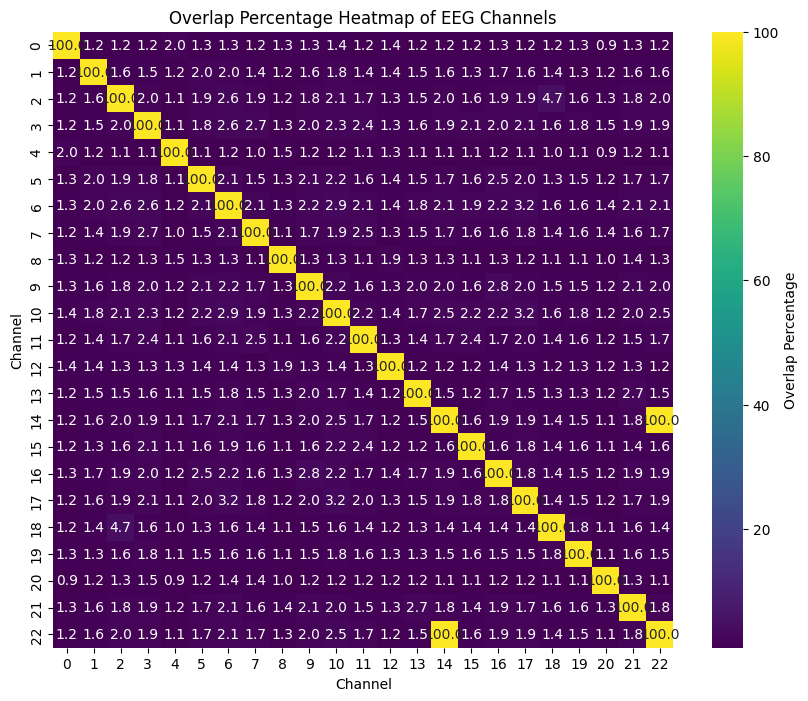

In [21]:
# Assuming `data` is already defined and has shape (samples, channels)
num_channels = data.shape[1]

# Create a matrix to store the overlap results as percentages
overlap_matrix = np.zeros((num_channels, num_channels), dtype=float)

# Compare each channel with every other channel
for i in range(num_channels):
    for j in range(i, num_channels):
        overlapping_values, total_values = compare_channels(data[:, i], data[:, j])
        overlap_percentage = (overlapping_values / total_values) * 100
        overlap_matrix[i, j] = overlap_percentage
        overlap_matrix[j, i] = overlap_percentage  # Since the matrix is symmetric

# print the highest and lowest overlap percentage above 0 and below 100
print("max: ", np.max(overlap_matrix[overlap_matrix < 100]))
print("min: ", np.min(overlap_matrix))

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(
    overlap_matrix,
    annot=True,
    fmt=".1f",
    cmap="viridis",
    cbar_kws={"label": "Overlap Percentage"},
)
plt.title("Overlap Percentage Heatmap of EEG Channels")
plt.xlabel("Channel")
plt.ylabel("Channel")
plt.show()

In [22]:
# extract the pairs of channels that have between 3 and 99% overlap
# Extract the pairs of channels that have between 3% and 99% overlap
overlap_threshold_min = 3
overlap_threshold_max = 99
overlapping_pairs = []

for i in range(num_channels):
    for j in range(i + 1, num_channels):  # Avoid duplicate pairs and self-comparison
        overlap_percentage = overlap_matrix[i, j]
        if overlap_threshold_min <= overlap_percentage <= overlap_threshold_max:
            overlapping_pairs.append((i, j, overlap_percentage))

# Print the overlapping pairs
for pair in overlapping_pairs:
    print(f"Channels {pair[0]} and {pair[1]} have {pair[2]:.1f}% overlap")

Channels 2 and 18 have 4.7% overlap
Channels 6 and 17 have 3.2% overlap
Channels 10 and 17 have 3.2% overlap


In [23]:
# print the binary in bits for channel 2:
# print the binary in bits for channel 2:
channel_2 = data[:, 1]  # Assuming channel indexing starts from 0

# Convert each value in channel 2 to its binary representation
binary_channel_2 = [
    format(value, "016b") for value in channel_2
]  # Assuming 16-bit integers

# Print the first 10 binary values for brevity
for i in range(len(binary_channel_2)):
    print(f"Sample {i}: {binary_channel_2[i]}")



Sample 0: -000000001101000
Sample 1: 0000000000000000
Sample 2: 0000000000000000
Sample 3: 0000000000000000
Sample 4: 0000000000000000
Sample 5: -000000000000001
Sample 6: -000000000000011
Sample 7: 0000000000000000
Sample 8: 0000000000000010
Sample 9: 0000000000000001
Sample 10: -000000000000101
Sample 11: -000000000010110
Sample 12: -000000000101010
Sample 13: -000000000110011
Sample 14: -000000000100111
Sample 15: -000000000011011
Sample 16: -000000000001111
Sample 17: -000000000001100
Sample 18: -000000000011011
Sample 19: -000000000100110
Sample 20: -000000000011001
Sample 21: -000000000010100
Sample 22: 0000000000000000
Sample 23: 0000000000001111
Sample 24: 0000000000000001
Sample 25: -000000000001101
Sample 26: -000000000010000
Sample 27: -000000000001100
Sample 28: -000000000000111
Sample 29: -000000000000010
Sample 30: -000000000000001
Sample 31: -000000000001010
Sample 32: -000000000010101
Sample 33: -000000000100100
Sample 34: -000000000101110
Sample 35: -000000000101111
Sa